# Image Translation Pipeline Test Notebook

This notebook explores the best pipeline for image reconstruction, through a series of experiments.

## Setup

In [23]:
OLLAMA_URL = "http://localhost:11434"   # Feel free to change if your Ollama port is different
MODEL = "qwen2.5vl:32b"                 # Our approach is tested with and works best with Qwen2.5-VL 32B.

!ollama pull $MODEL
!ollama serve

pulling manifest ⠋ pulling manifest ⠙ pulling manifest ⠹ pulling manifest ⠸ pulling manifest ⠼ pulling manifest ⠴ pulling manifest ⠦ pulling manifest ⠧ pulling manifest ⠇ pulling manifest ⠏ pulling manifest ⠋ pulling manifest ⠙ pulling manifest ⠹ pulling manifest ⠸ pulling manifest ⠼ pulling manifest 
pulling 043a363c6ca3:   0% ▕                  ▏ 2.2 MB/ 21 GB                  pulling manifest 
pulling 043a363c6ca3:   0% ▕                  ▏  14 MB/ 21 GB                  pulling manifest 
pulling 043a363c6ca3:   0% ▕                  ▏  20 MB/ 21 GB                  pulling manifest 
pulling 043a363c6ca3:   0% ▕                  ▏  33 MB/ 21 GB                  pulling manifest 
pulling 043a363c6ca3:   0% ▕                  ▏  44 MB/ 21 GB                  pulling manifest 
pulling 043a363c6ca3:   0% ▕                  ▏  50 MB/ 21 GB                  pulling manifest 
pulling 043a363c6ca3:   0% ▕                  ▏  55 MB/ 21 GB                  pulling manifest 
pulling 043a363c6c

In [1]:
!git clone https://huggingface.co/Qwen/Qwen-Image-Edit-2509 ./models/Qwen-Image-2509

Cloning into './models/Qwen-Image-2509'...
Filtering content:  18% (2/11)
Filtering content:  18% (2/11), 2.49 GiB | 12.99 MiB/s
Filtering content:  27% (3/11), 2.49 GiB | 12.99 MiB/s
Filtering content:  27% (3/11), 2.72 GiB | 13.31 MiB/s
Filtering content:  36% (4/11), 2.72 GiB | 13.31 MiB/s
Filtering content:  45% (5/11), 2.72 GiB | 13.31 MiB/s
Filtering content:  45% (5/11), 3.33 GiB | 6.67 MiB/s 
Filtering content:  54% (6/11), 3.33 GiB | 6.67 MiB/s
Filtering content:  54% (6/11), 3.95 GiB | 7.91 MiB/s
Filtering content:  63% (7/11), 3.95 GiB | 7.91 MiB/s
Filtering content:  63% (7/11), 4.60 GiB | 8.88 MiB/s
Filtering content:  72% (8/11), 4.60 GiB | 8.88 MiB/s
Filtering content:  72% (8/11), 5.85 GiB | 562.00 KiB/s
Filtering content:  81% (9/11), 5.85 GiB | 562.00 KiB/s
Filtering content:  81% (9/11), 7.14 GiB | 2.74 MiB/s  
Filtering content:  90% (10/11), 7.14 GiB | 2.74 MiB/s
Filtering content:  90% (10/11), 8.44 GiB | 4.53 MiB/s
Filtering content: 100% (11/11), 8.44 GiB | 4.53

In [3]:
%pip install git+https://github.com/huggingface/diffusers
%pip install -r requirements.txt
%pip install torch torchvision --index-url https://download.pytorch.org/whl/cu129

  Cloning https://github.com/huggingface/diffusers to c:\users\standard\appdata\local\temp\pip-req-build-mbc6x3sh
  Resolved https://github.com/huggingface/diffusers to commit dcb6dd9b7a6c7ddd6875506f40597c0976fd02c5
  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Getting requirements to build wheel: started
  Getting requirements to build wheel: finished with status 'done'
  Preparing metadata (pyproject.toml): started
  Preparing metadata (pyproject.toml): finished with status 'done'
Note: you may need to restart the kernel to use updated packages.


  Running command git clone --filter=blob:none --quiet https://github.com/huggingface/diffusers 'C:\Users\standard\AppData\Local\Temp\pip-req-build-mbc6x3sh'


  Using cached accelerate-1.10.1-py3-none-any.whl.metadata (19 kB)
Using cached accelerate-1.10.1-py3-none-any.whl (374 kB)
Note: you may need to restart the kernel to use updated packages.
Looking in indexes: https://download.pytorch.org/whl/cu129
Note: you may need to restart the kernel to use updated packages.


In [28]:
import os
from PIL import Image, ImageDraw, ImageFilter
import torch
from ollama import chat
from ollama import ChatResponse
from diffusers import QwenImageEditPipeline
import base64

### Pipeline loading

In [2]:
pipeline = QwenImageEditPipeline.from_pretrained("Qwen/Qwen-Image-Edit")
print("Pipeline loaded.")

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

Loading checkpoint shards:   0%|          | 0/9 [00:00<?, ?it/s]

Loading checkpoint shards:   0%|          | 0/4 [00:00<?, ?it/s]

Pipeline loaded.


In [3]:
pipeline.to(torch.float32) # Inference in mixed precision (torch.bfloat16, raccomended for faster inference). However, if you are making inference through CPU, please use full precision (torch.float32)
pipeline.to("cpu")         # Change to "cpu" if CUDA is not supported by your machine. The inference will be slower.
pipeline.set_progress_bar_config(disable=False)

In [9]:
def generate_image(inputs, output_filename = "output_edit.jpeg"):
    with torch.inference_mode():
        output = pipeline(**inputs)
        output_image = output.images[0]
        output_image.save(output_filename)
        print("Image generated (saved!)")
    return output_image

def make_inputs(images: list[Image], prompt: str, guidance = 4.0, neg_prompt = " ", inf_steps = 50):
    return {
    "image": images,
    "prompt": prompt,
    "generator": torch.manual_seed(0),
    "true_cfg_scale": guidance,
    "negative_prompt": neg_prompt,
    "num_inference_steps": inf_steps,
    }

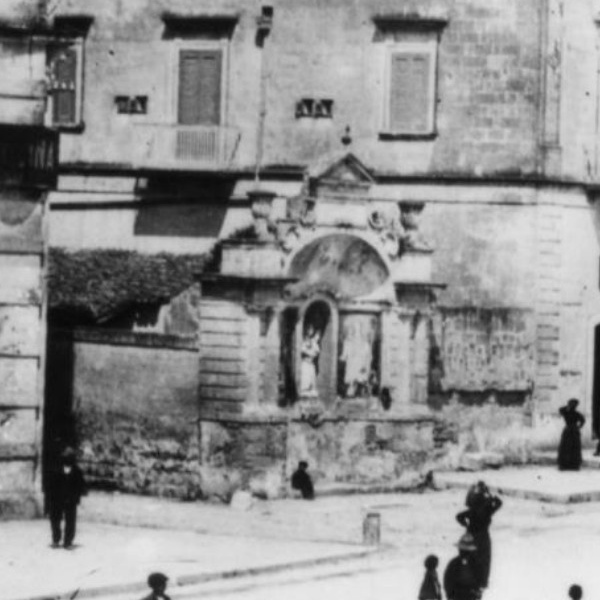

In [4]:
image_full = Image.open("assets/eustachian_monument.jpeg").convert("RGB")
image_roi = image_full.crop((200, 500, 800, 1100))
image_roi

---

## Test 1: Full image rotation

In [ ]:
images = [image_full]
prompt = "Rotate the main subject, so that it looks in front view."
inputs = make_inputs(images, prompt)
output_image = generate_image(inputs, "examples/output_fp_full.jpeg")

  0%|          | 0/50 [00:00<?, ?it/s]

Image generated (saved!)


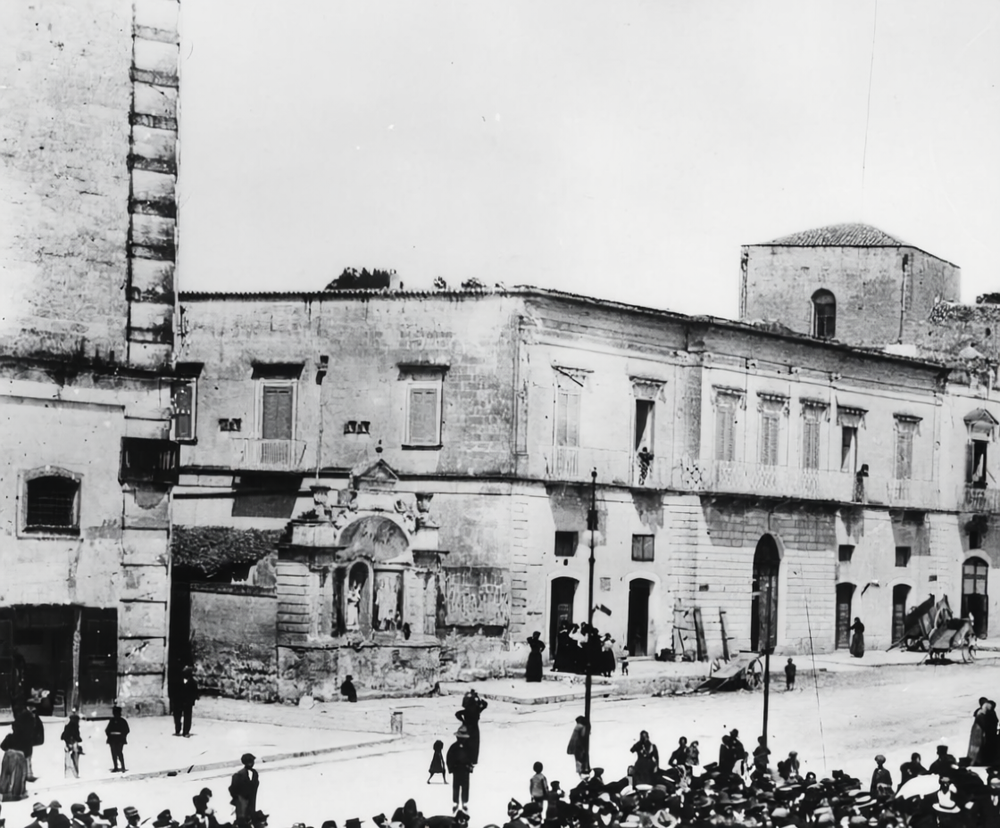

In [16]:
output_image

### On a ROI

In [17]:
images = [image_roi]
prompt = "Rotate the main subject, so that it looks in front view."
inputs = make_inputs(images, prompt)
output_image = generate_image(inputs,  "examples/output_fp_roi.jpeg")

  0%|          | 0/50 [00:00<?, ?it/s]

Image generated (saved!)


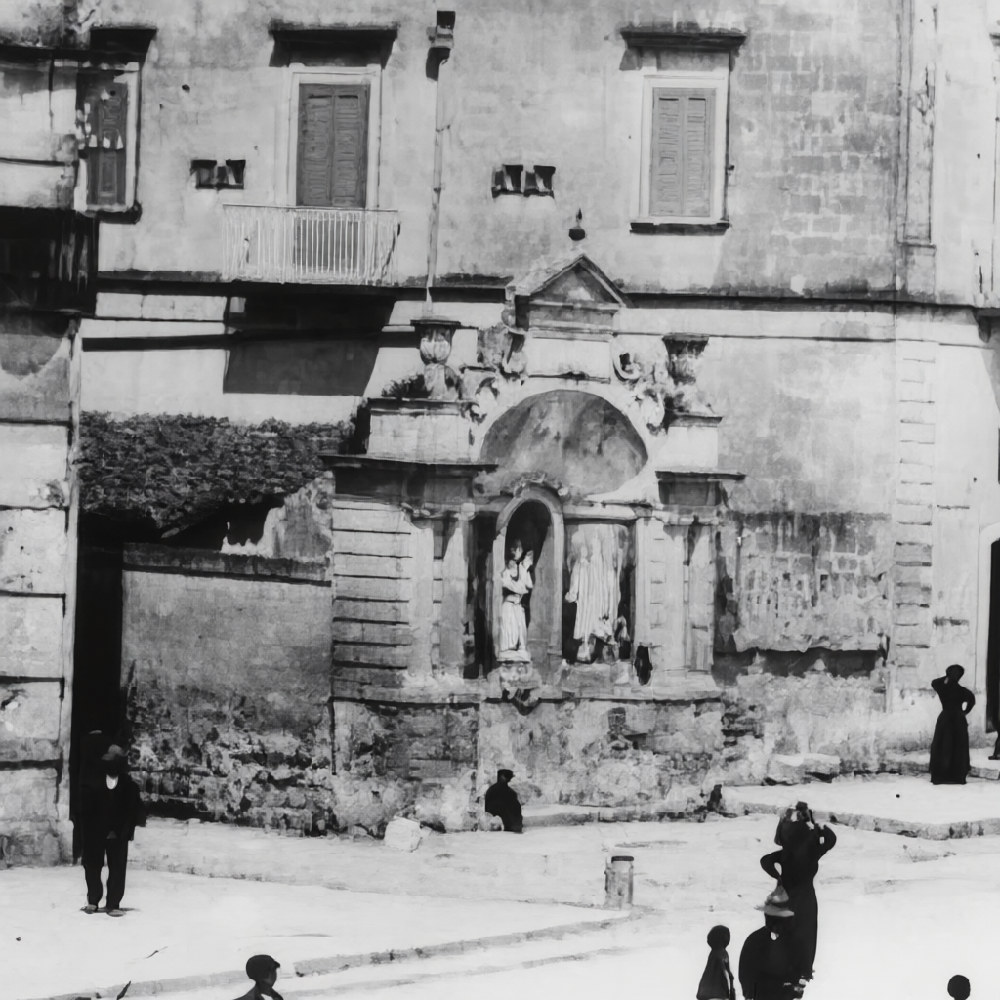

In [18]:
output_image

---
### Prompt enhancement

Full Image

In [10]:
images = [image_full]
prompt = """
    Rotate the monument, so that its facade looks in front view.
    The monument is the small building on the left half of the image, containing three niches, with statues inside it.
    """
inputs = make_inputs(images, prompt)
output_image = generate_image(inputs, "examples/output_fp_full_better_prompt.jpeg")

  0%|          | 0/50 [00:00<?, ?it/s]

Image generated (saved!)


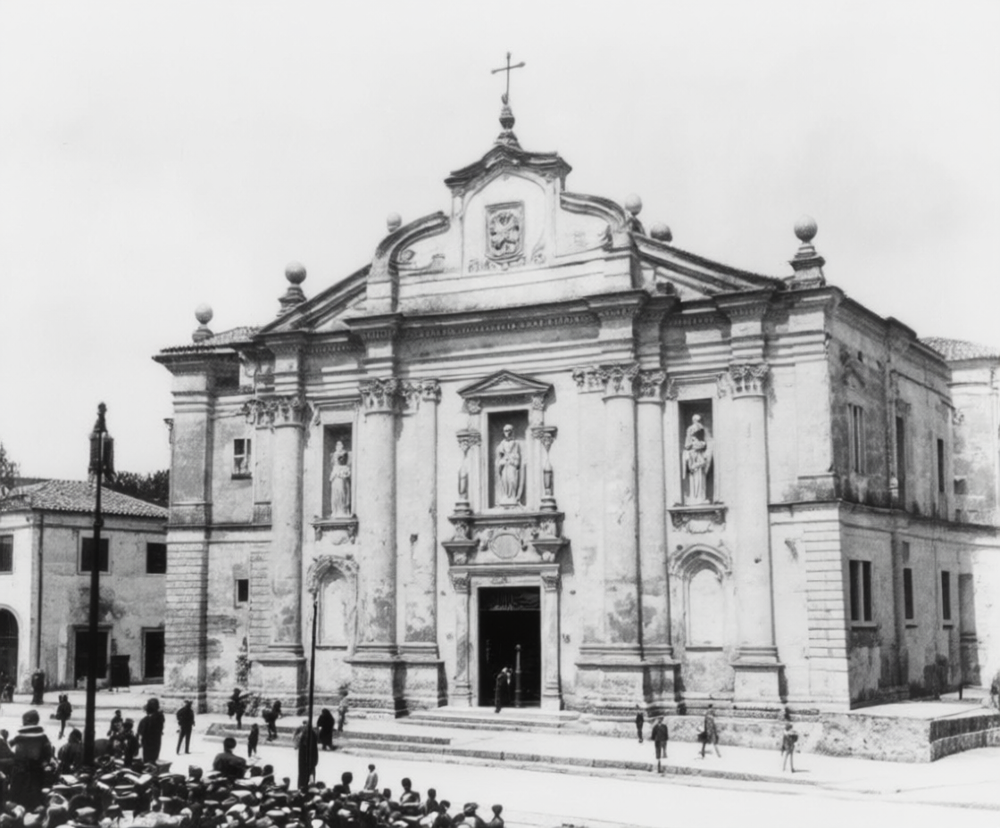

In [11]:
output_image

ROI

In [12]:
images = [image_roi]
prompt = """
    Rotate the monument, so that its facade looks in front view.
    The monument is the small building, depicted in the center of the image.
    """
inputs = make_inputs(images, prompt)
output_image = generate_image(inputs, "examples/output_fp_roi_better_prompt.jpeg")

  0%|          | 0/50 [00:00<?, ?it/s]

Image generated (saved!)


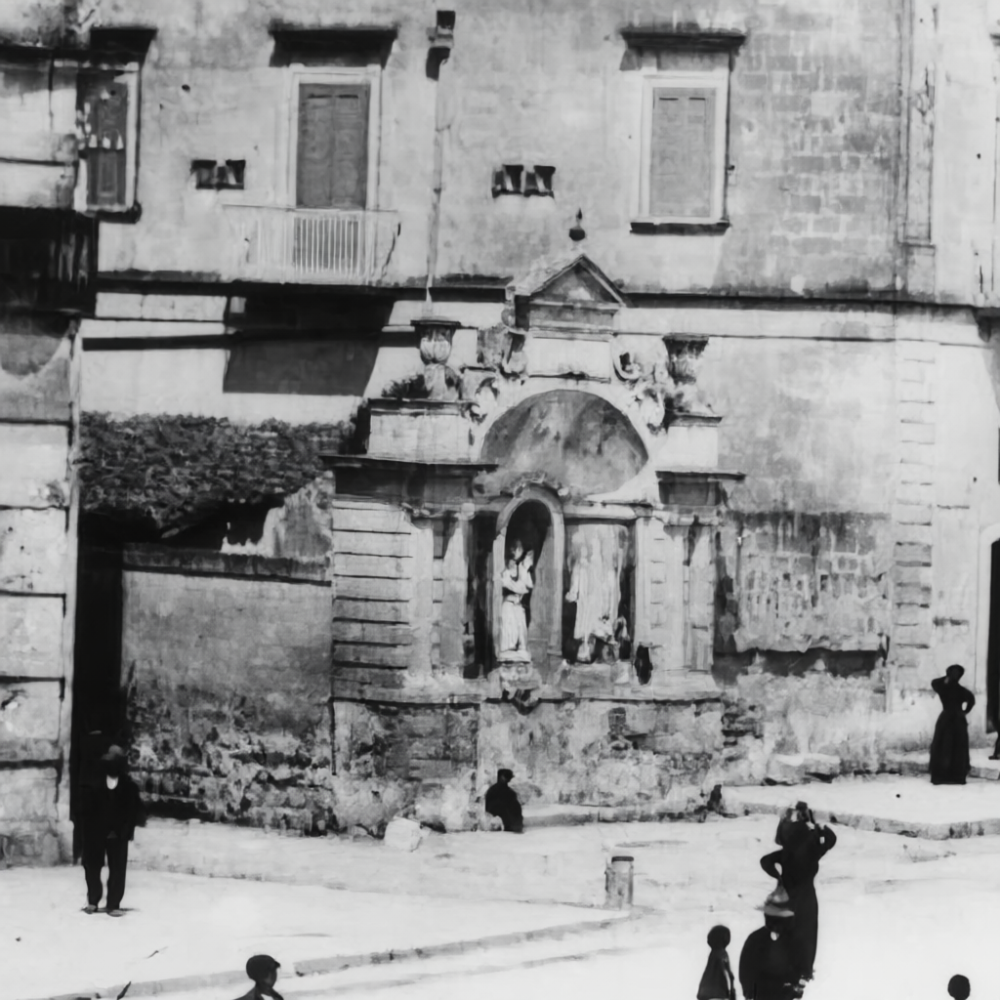

In [13]:
output_image

## Test 2: Pre-enhancing, then rotation

### Full Image

In [14]:
images = [image_full]
prompt = "Enhance the image details, so that the depicted images get more evident. Stay consistent with the original image style and color."
inputs = make_inputs(images, prompt)
output_image = generate_image(inputs,  "examples/output_fp_full_enhanced.jpeg")

  0%|          | 0/50 [00:00<?, ?it/s]

Image generated (saved!)


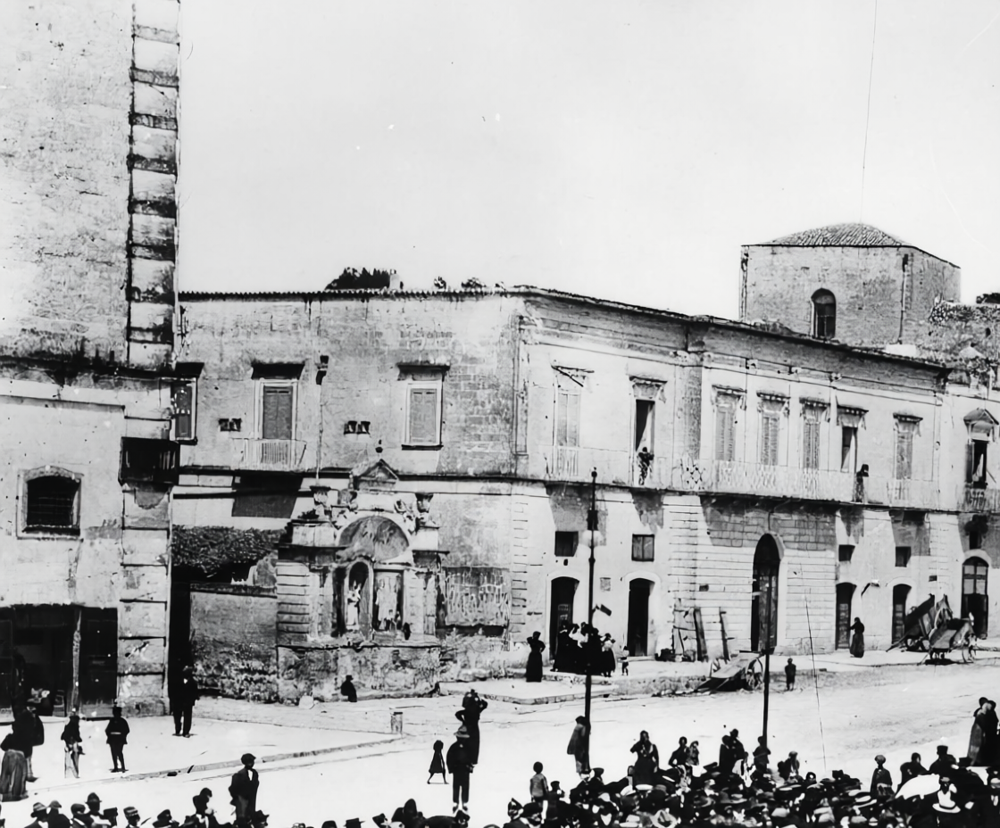

In [15]:
output_image

In [ ]:
images = [output_image]
prompt = "Rotate the main subject, so that it looks in front view."
inputs = make_inputs(images, prompt)
output_image = generate_image(inputs,  "examples/output_fp_full_prenh.jpeg")

  0%|          | 0/50 [00:00<?, ?it/s]

Image generated (saved!)


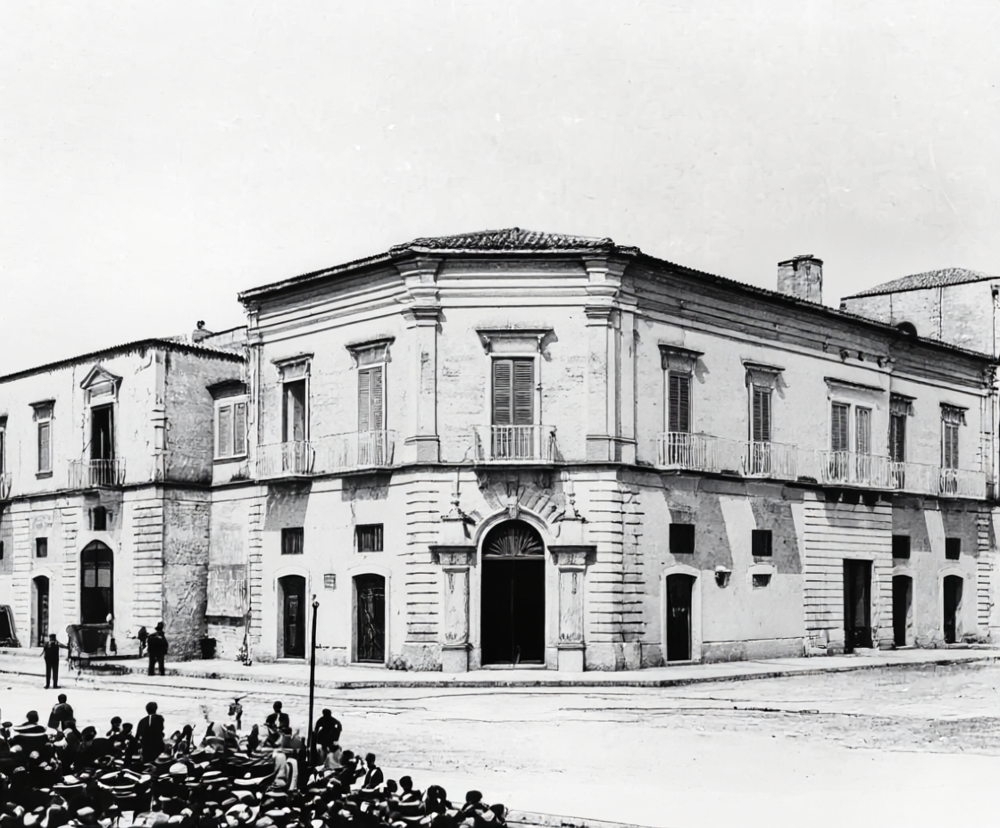

In [22]:
output_image

### ROI


In [16]:
images = [image_roi]
prompt = "Enhance the image details, so that the depicted images get more evident. Stay consistent with the original image style and color."
inputs = make_inputs(images, prompt)
output_image = generate_image(inputs,  "examples/output_fp_roi_enhanced.jpeg")

  0%|          | 0/50 [00:00<?, ?it/s]

Image generated (saved!)


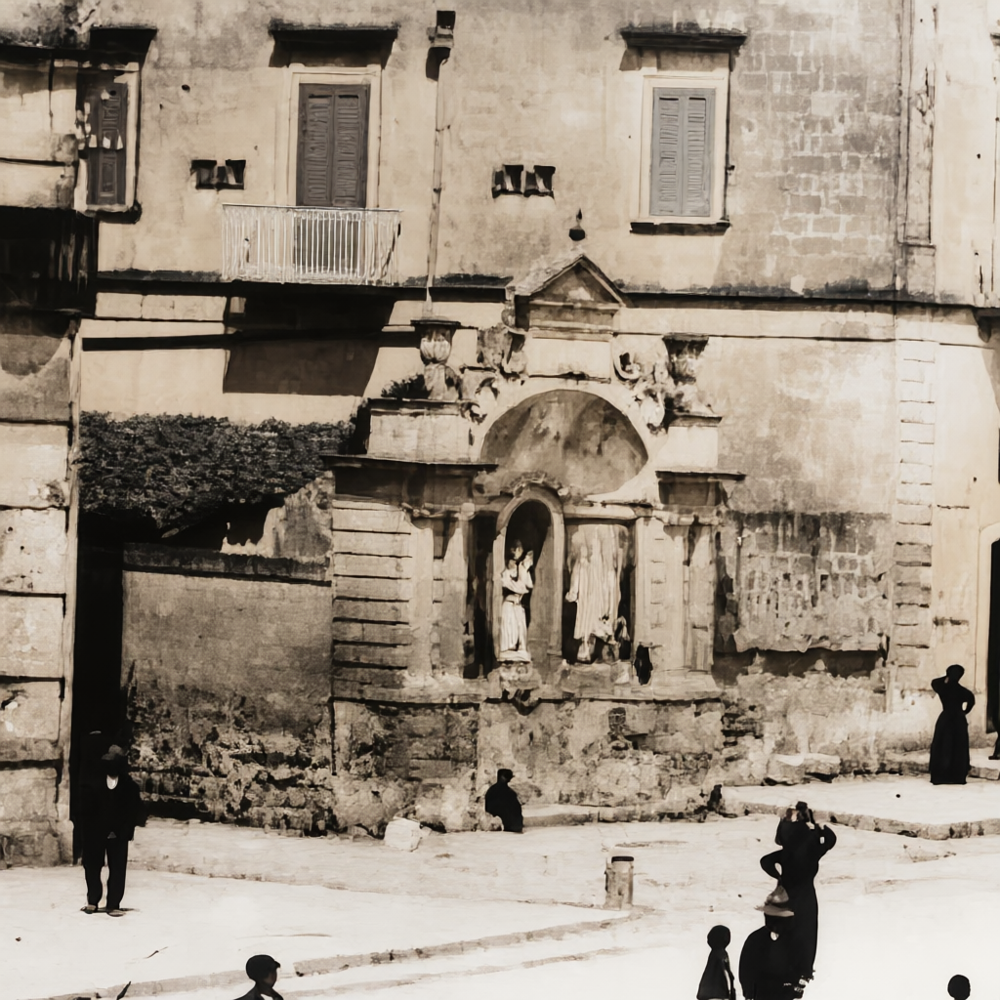

In [17]:
output_image

In [ ]:
images = [output_image]
prompt = "Rotate the main subject, so that it looks in front view."
inputs = make_inputs(images, prompt)
output_image = generate_image(inputs,  "examples/output_fp_roi_prenh.jpeg")

  0%|          | 0/50 [00:00<?, ?it/s]

Image generated (saved!)


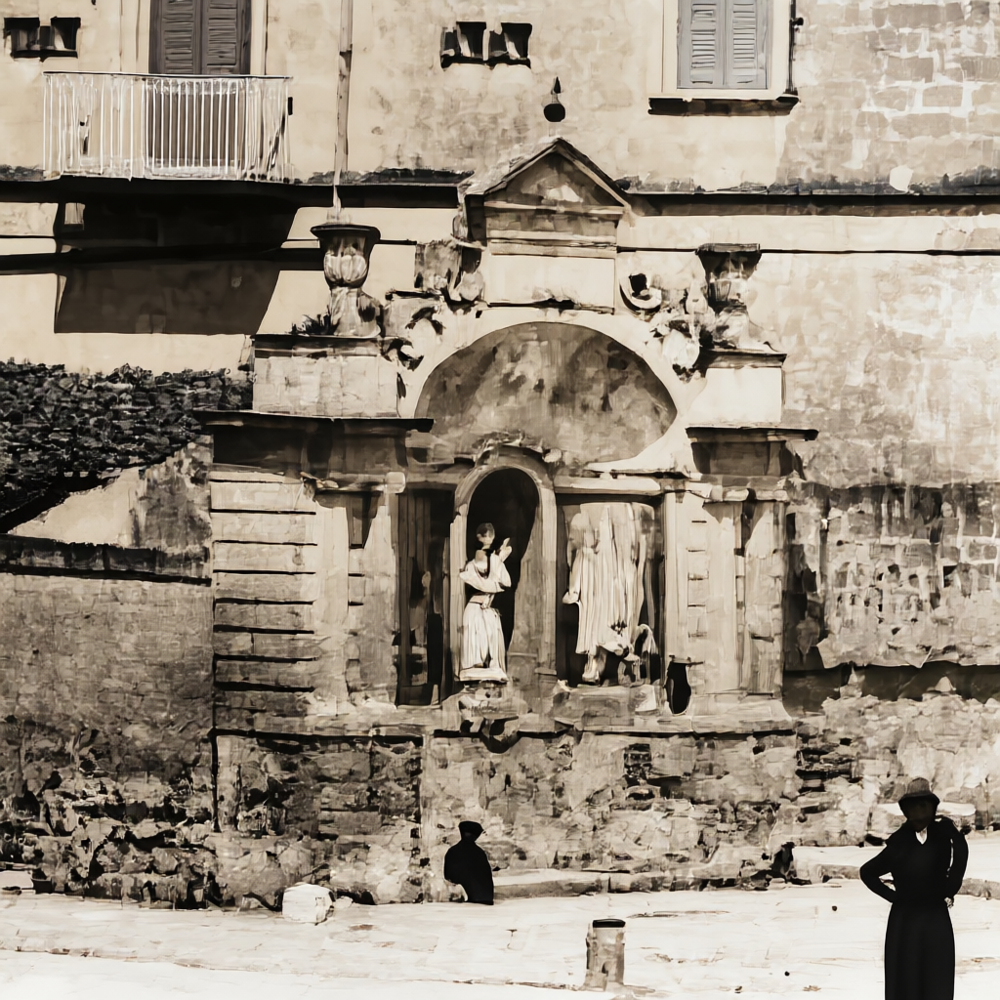

In [26]:
output_image

---
### Prompt enhancement

> Please note!
> 
> To be able to execute the cells below, make sure you have generated (and saved) the enhanced versions of both full and roi image.
>

Full Image

In [18]:
images = [Image.open("examples/output_fp_full_enhanced.jpeg").convert("RGB")]
prompt = """
    Rotate the monument, so that its facade looks in front view.
    The monument is the small building on the left half of the image, containing three niches, with statues inside it.
    """
inputs = make_inputs(images, prompt)
output_image = generate_image(inputs, "examples/output_fp_full_better_prompt.jpeg")

  0%|          | 0/50 [00:00<?, ?it/s]

Image generated (saved!)


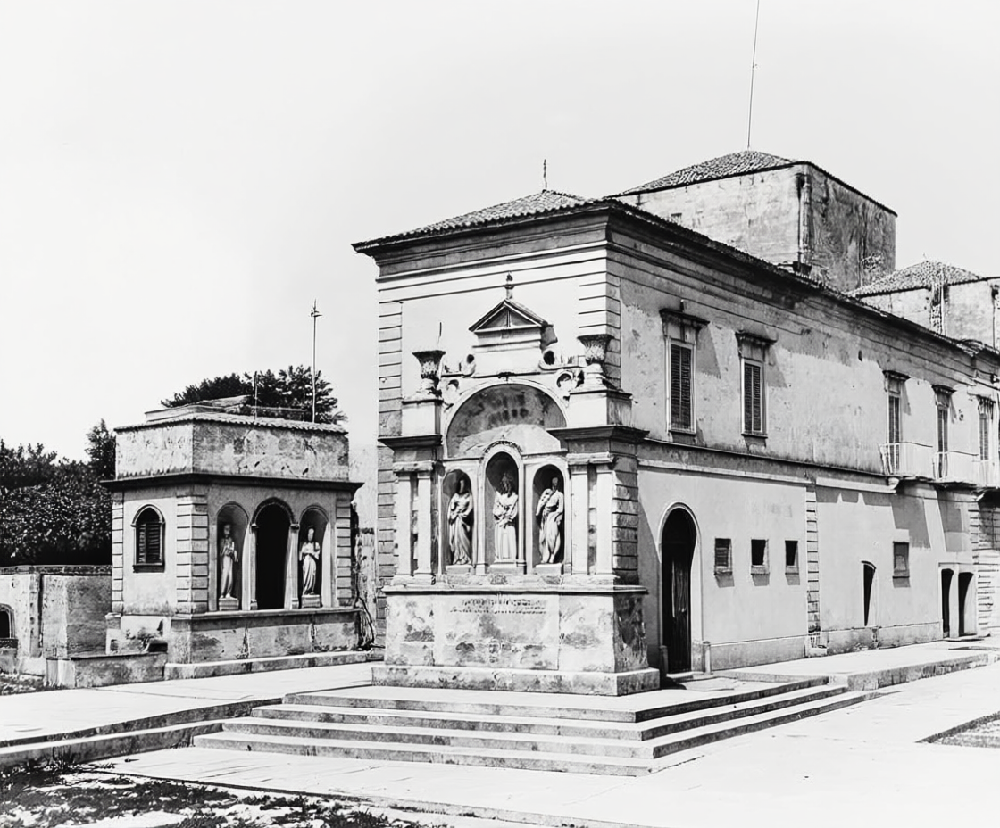

In [19]:
output_image

ROI

In [20]:
images = [Image.open("examples/output_fp_roi_enhanced.jpeg").convert("RGB")]
prompt = """
    Rotate the monument, so that its facade looks in front view.
    The monument is the small building, depicted in the center of the image.
    """
inputs = make_inputs(images, prompt)
output_image = generate_image(inputs, "examples/output_fp_roi_better_prompt.jpeg")

  0%|          | 0/50 [00:00<?, ?it/s]

Image generated (saved!)


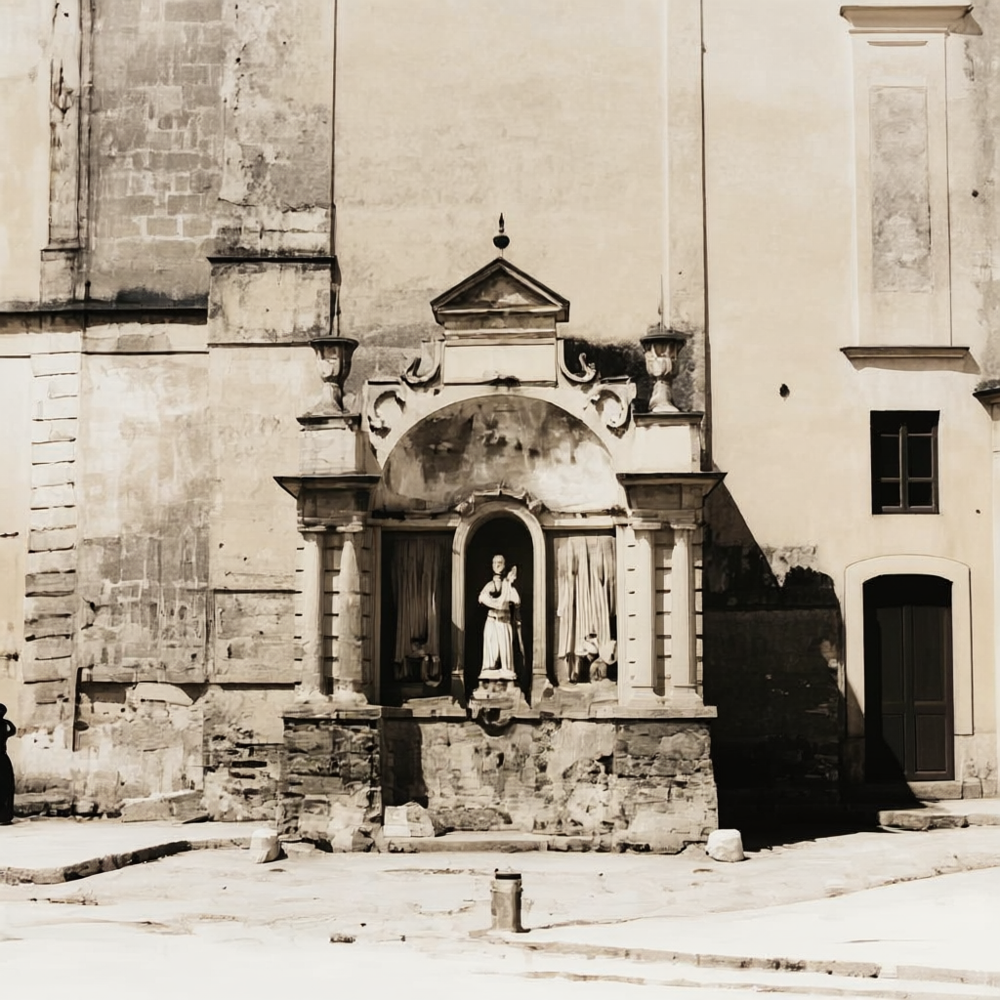

In [21]:
output_image

## Test 4: VL-Driven best selection

In [ ]:
output_images = []
for i in range(4):
    images = [Image.open("examples/output_fp_roi_enhanced.jpeg").convert("RGB")]
    prompt = """
        Rotate the monument, so that its facade looks in front view.
        The monument is the small building, depicted in the center of the image.
        """
    inputs = make_inputs(images, prompt)
    output_images[i] = generate_image(inputs, f"examples/best-sel/for_best_selection_{i}.jpeg")

In [ ]:
vl_prompt = f"""
  You are a bot capable of determining whether an image depicts its main subject with their facade in front view or not.
  Given the image of the subject (first image) in lateral view, give each of the subsequent images a rating from 0 to 5 (0: subject in lateral view, 5: subject facade in front view).
  Then, give each of the subsequent images a rating from 0 to 5 based on subject resemblance (0: subject is not the same, 5: the subject is the same)
  
  Reply for each image, with its corresponding number in the former list, without any comment.
"""

response: ChatResponse = chat(model=MODEL, messages=[
  {
    'role': 'user',
    'content': vl_prompt,
    'images': [
        "examples/output_fp_roi_better_prompt.jpeg",
        "examples/best-sel/for_best_selection_0.jpeg",
        "examples/best-sel/for_best_selection_1.jpeg",
        "examples/best-sel/for_best_selection_2.jpeg",
        "examples/best-sel/for_best_selection_3.jpeg",
    ]
  },
])
print(response['message']['content'])

Image 2: 5 (subject facade in front view)  
Image 3: 5 (subject facade in front view)  
Image 4: 5 (subject facade in front view)  

Subject resemblance ratings:  
Image 2: 3 (subject is similar but not the same)  
Image 3: 4 (subject is quite similar)  
Image 4: 4 (subject is quite similar)  


---

# Impainting

Based on best results

## Test 1: All-at-once

In [ ]:
images = [Image.open("examples/output_fp_roi_better_prompt.jpeg"), Image.open("assets/stEustace.jpg"), Image.open("assets/stVitus.jpg")]
prompt = """
    Given the image of the monument, the main building at the center of the image, put the statues of the saints inside its lateral niches.
    The statues need to be in the exact same style of the monument image.
    Preserve each image's detail.
"""
inputs = make_inputs(images, prompt)
output_image = generate_image(inputs, f"examples/inpaint_oao.jpeg")

In [ ]:
output_image